In [1]:
from __future__ import absolute_import, division, print_function

import argparse
import os

import warnings ; warnings.filterwarnings('ignore')
os.environ['CUDA_DEVICE_ORDER']='PCI_BUS_ID'
os.environ['OMP_NUM_THREADS'] = '1'
import argparse
import collections
import os
import random
import tempfile
from argparse import RawTextHelpFormatter

import gfootball.env as football_env
import gym
import numpy as np
import ray
import ray.cloudpickle as cloudpickle
import torch
from gfootball import env as fe
from ray import tune
from ray.rllib.agents import ppo
from ray.rllib.policy.sample_batch import SampleBatch
from ray.rllib.utils.spaces.space_utils import flatten_to_single_ndarray
from ray.tune.registry import get_trainable_cls, register_env
from rldm.utils import football_tools as ft
from rldm.utils import gif_tools as gt
from rldm.utils import system_tools as st
from IPython.display import HTML

/opt/conda/lib/python3.7/site-packages/ale_py/roms/utils.py:90: DeprecationWarning: SelectableGroups dict interface is deprecated. Use select.
  for external in metadata.entry_points().get(self.group, []):


In [2]:
class DefaultMapping(collections.defaultdict):
    """default_factory now takes as an argument the missing key."""

    def __missing__(self, key):
        self[key] = value = self.default_factory(key)
        return value

STAT_FUNC = {
    'min': np.min,
    'mean': np.mean,
    'median': np.median,
    'max': np.max,
    'std': np.std,
    'var': np.var,
}

In [3]:
!rm -rf /tmp/football/*

In [4]:
!ls -l /mnt/logs/baselines/**/**

-rw-r--r-- 1 jovyan 1000 2187 Oct 28 04:01 /mnt/logs/baselines/baseline_1/params.json
-rw-r--r-- 1 jovyan 1000 3210 Oct 28 04:01 /mnt/logs/baselines/baseline_1/params.pkl
-rw-r--r-- 1 jovyan 1000 2186 Oct 28 04:01 /mnt/logs/baselines/baseline_2/params.json
-rw-r--r-- 1 jovyan 1000 3213 Oct 28 04:01 /mnt/logs/baselines/baseline_2/params.pkl
-rw-r--r-- 1 jovyan 1000 2200 Oct 28 04:01 /mnt/logs/baselines/baseline_3/params.json
-rw-r--r-- 1 jovyan 1000 3211 Oct 28 04:01 /mnt/logs/baselines/baseline_3/params.pkl

/mnt/logs/baselines/baseline_1/checkpoint_0:
total 14776
-rw-r--r-- 1 jovyan 1000 15122983 Oct 28 04:01 checkpoint-0
-rw-r--r-- 1 jovyan 1000      184 Oct 28 04:01 checkpoint-0.tune_metadata

/mnt/logs/baselines/baseline_2/checkpoint_0:
total 10932
-rw-r--r-- 1 jovyan 1000 11187733 Oct 28 04:01 checkpoint-0
-rw-r--r-- 1 jovyan 1000      184 Oct 28 04:01 checkpoint-0.tune_metadata

/mnt/logs/baselines/baseline_3/checkpoint_0:
total 13876
-rw-r--r-- 1 jovyan 1000 14201366 Oct 28 04:0

In [5]:
# CHECKPOINT TO LOAD
# here are some example checkpoints from the baseline teams...
checkpoint = "/mnt/logs/baselines/baseline_1/checkpoint_0/checkpoint-0"
# checkpoint = "/mnt/logs/baselines/baseline_2/checkpoint_0/checkpoint-0"
# checkpoint = "/mnt/logs/baselines/baseline_3/checkpoint_0/checkpoint-0"

num_episodes = 10
debug = False
algorithm = "PPO"

In [6]:
assert checkpoint, "A checkpoint string is required"

assert num_episodes <= 10, "Must rollout a maximum of 10 episodes--rendering takes a very long time"
assert num_episodes >= 1, "Must rollout at least 1 episode"

n_cpus, _ = st.get_cpu_gpu_count()
assert n_cpus >= 2, "Didn't find enough cpus"

config = {}
config_dir = os.path.dirname(checkpoint)
config_path = os.path.join(config_dir, "../params.pkl")

assert os.path.exists(config_path), "Could not find a proper config from checkpoint"
with open(config_path, "rb") as f:
    config = cloudpickle.load(f)

config["create_env_on_driver"] = True
config["log_level"] = 'DEBUG' if debug else 'ERROR' 
config["num_workers"] = 1
config["num_gpus"] = 0

In [7]:
ray.init(ignore_reinit_error=True, log_to_driver=debug, include_dashboard=False,
         local_mode=True, logging_level='DEBUG' if debug else 'ERROR')

{'node_ip_address': '172.17.0.2',
 'raylet_ip_address': '172.17.0.2',
 'redis_address': '172.17.0.2:32279',
 'object_store_address': '/tmp/ray/session_2021-10-28_04-06-16_098158_397/sockets/plasma_store',
 'raylet_socket_name': '/tmp/ray/session_2021-10-28_04-06-16_098158_397/sockets/raylet',
 'webui_url': None,
 'session_dir': '/tmp/ray/session_2021-10-28_04-06-16_098158_397',
 'metrics_export_port': 53822,
 'node_id': '8ab6b6d900e4afac6c220277ecc6802c02e92b5db2a5a5792ffe9d8f'}

In [8]:
register_env(config['env'], lambda _: ft.RllibGFootball(env_name=config['env']))
    
cls = get_trainable_cls(algorithm)
agent = cls(env=config['env'], config=config)
agent.restore(checkpoint)

In [9]:
try:
    del env
except:
    pass

env = ft.RllibGFootball(env_name=config['env'], write_video=True, render=True)

In [10]:
policy_agent_mapping = agent.config["multiagent"]["policy_mapping_fn"]
policy_map = agent.workers.local_worker().policy_map
state_init = {p: m.get_initial_state() for p, m in policy_map.items()}
use_lstm = {p: len(s) > 0 for p, s in state_init.items()}

action_init = {
    p: flatten_to_single_ndarray(m.action_space.sample())
    for p, m in policy_map.items()
}

eps_stats = {}
eps_stats['rewards_total'] = []
eps_stats['timesteps'] = []
eps_stats['score_reward'] = []
eps_stats['win_perc'] = []
eps_stats['undefeated_perc'] = []
for eidx in range(num_episodes):
    mapping_cache = {}  # in case policy_agent_mapping is stochastic

    obs = env.reset()
    agent_states = DefaultMapping(
        lambda player_id: state_init[mapping_cache[player_id]])
    prev_actions = DefaultMapping(
        lambda player_id: action_init[mapping_cache[player_id]])
    prev_rewards = collections.defaultdict(lambda: 0.)

    done = False
    eps_stats['rewards_total'].append({a:0.0 for a in obs})
    eps_stats['timesteps'].append(-1)
    eps_stats['score_reward'].append(0)
    eps_stats['win_perc'].append(0)
    eps_stats['undefeated_perc'].append(0)
    while not done:
        actions = {}
        for player_id, a_obs in obs.items():
            policy_id = mapping_cache.setdefault(
                player_id, policy_agent_mapping(player_id, None))
            p_use_lstm = use_lstm[policy_id]
            if p_use_lstm:
                a_action, p_state, _ = agent.compute_single_action(
                    a_obs,
                    state=agent_states[player_id],
                    prev_action=prev_actions[player_id],
                    prev_reward=prev_rewards[player_id],
                    policy_id=policy_id)
                agent_states[player_id] = p_state
            else:
                a_action = agent.compute_single_action(
                    a_obs,
                    prev_action=prev_actions[player_id],
                    prev_reward=prev_rewards[player_id],
                    policy_id=policy_id)

            a_action = flatten_to_single_ndarray(a_action)
            actions[player_id] = a_action
            prev_actions[player_id] = a_action

        next_obs, rewards, dones, infos = env.step(actions)

        done = dones['__all__']
        for player_id, r in rewards.items():
            prev_rewards[player_id] = r
            eps_stats['rewards_total'][-1][player_id] += r

        obs = next_obs
        eps_stats['timesteps'][-1] += 1

    eps_stats['score_reward'][-1] = infos['player_0']['score_reward']
    game_result = "loss" if infos['player_0']['score_reward'] == -1 else \
        "win" if infos['player_0']['score_reward'] == 1 else "tie"
    eps_stats['win_perc'][-1] = int(game_result == "win")
    eps_stats['undefeated_perc'][-1] = int(game_result != "loss")
    print(f"\nEpisode #{eidx+1} ended with a {game_result}:")
    for p, r in eps_stats['rewards_total'][-1].items():
        print("\t{} got episode reward: {:.2f}".format(p, r))
    print("\tTotal reward: {:.2f}".format(sum(eps_stats['rewards_total'][-1].values())))

eps_stats['rewards_total'] = {k: [dic[k] for dic in eps_stats['rewards_total']] \
    for k in eps_stats['rewards_total'][0]}
print("\n\nAll trials completed:")
for stat_name, values in eps_stats.items():
    print(f"\t{stat_name}:")
    if type(values) is dict:
        for stat_name2, values2 in values.items():
            print(f"\t\t{stat_name2}:")
            for func_name, func in STAT_FUNC.items():
                print("\t\t\t{}: {:.2f}".format(func_name, func(values2)))
    else:
        for func_name, func in STAT_FUNC.items():
            print("\t\t{}: {:.2f}".format(func_name, func(values)))


Episode #1 ended with a win:
	player_0 got episode reward: 2.00
	player_1 got episode reward: 2.00
	Total reward: 4.00

Episode #2 ended with a tie:
	player_0 got episode reward: 0.00
	player_1 got episode reward: 0.00
	Total reward: 0.00

Episode #3 ended with a win:
	player_0 got episode reward: 2.00
	player_1 got episode reward: 2.00
	Total reward: 4.00

Episode #4 ended with a loss:
	player_0 got episode reward: -1.00
	player_1 got episode reward: -1.00
	Total reward: -2.00

Episode #5 ended with a win:
	player_0 got episode reward: 2.00
	player_1 got episode reward: 2.00
	Total reward: 4.00

Episode #6 ended with a tie:
	player_0 got episode reward: 0.00
	player_1 got episode reward: 0.00
	Total reward: 0.00

Episode #7 ended with a win:
	player_0 got episode reward: 2.00
	player_1 got episode reward: 2.00
	Total reward: 4.00

Episode #8 ended with a tie:
	player_0 got episode reward: 0.00
	player_1 got episode reward: 0.00
	Total reward: 0.00

Episode #9 ended with a win:
	playe

In [11]:
!ls /tmp/football

episode_done_20211028-040655721558.avi
episode_done_20211028-040655721558.dump
episode_done_20211028-040724085599.avi
episode_done_20211028-040724085599.dump
episode_done_20211028-040829957505.avi
episode_done_20211028-040829957505.dump
episode_done_20211028-040842913631.avi
episode_done_20211028-040842913631.dump
episode_done_20211028-040911692390.avi
episode_done_20211028-040911692390.dump
episode_done_20211028-040923106983.avi
episode_done_20211028-040923106983.dump
episode_done_20211028-041024159418.avi
episode_done_20211028-041024159418.dump
episode_done_20211028-041036025220.avi
episode_done_20211028-041036025220.dump
episode_done_20211028-041043871151.avi
episode_done_20211028-041043871151.dump
episode_done_20211028-041056595647.avi
episode_done_20211028-041056595647.dump
lost_score_20211028-040908452704.avi
lost_score_20211028-040908452704.dump
score_20211028-040717061362.avi
score_20211028-040717061362.dump
score_20211028-040840144911.avi
score_20211028-040840144911.dump
score


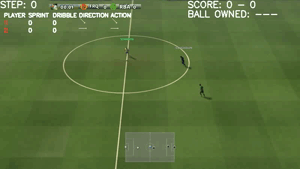
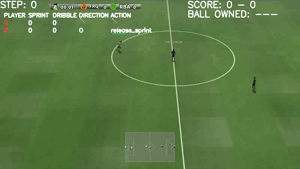
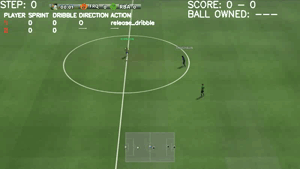
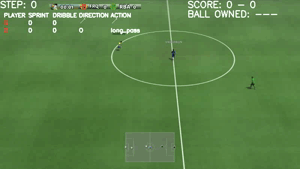
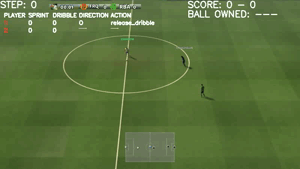
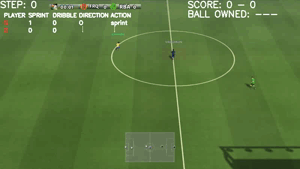
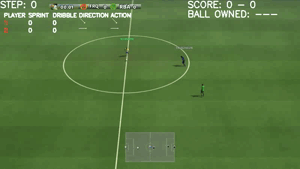
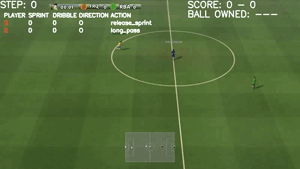
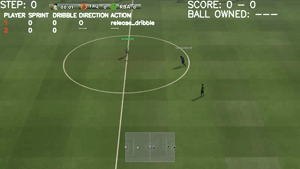
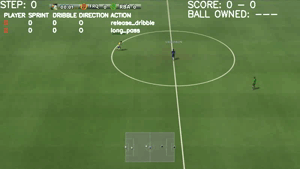

In [12]:
data = gt.get_gif_html(videos_path="/tmp/football/episode_done_*.avi", 
                       title="Full episodes")
HTML(data=data)


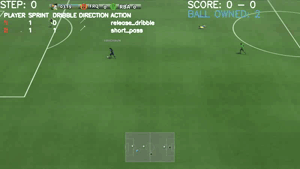

In [13]:
data = gt.get_gif_html(videos_path="/tmp/football/lost_score_*.avi", 
                       title="Lost episodes")
HTML(data=data)


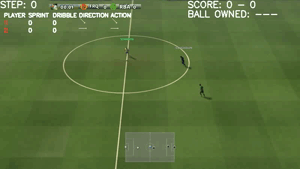
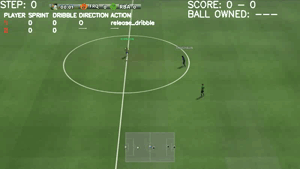
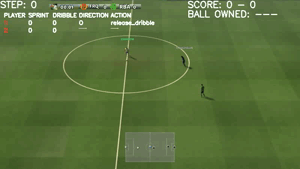
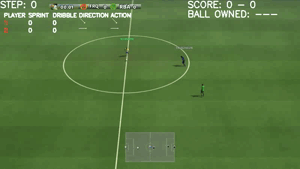
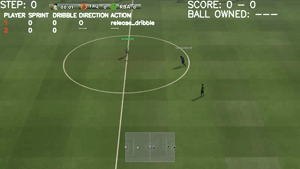

In [14]:
data = gt.get_gif_html(videos_path="/tmp/football/score_*.avi", 
                       title="Won episodes")
HTML(data=data)